# GWAS-ATLAS & MAGMA investigation

In [1]:
%load_ext autoreload
%autoreload 2

In [2]:
import pandas as pd
import json, urllib.request
import requests
import time
import pickle

from tqdm.auto import trange
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

In [3]:
import joblib

In [4]:
def download_magma_genes(study_id):
    url = f'https://atlas.ctglab.nl/traitDB/manhattan/{study_id}/magma.genes.out' 
    data = urllib.request.urlopen(url).read()
    output = json.loads(data)
    df = pd.DataFrame(output, columns=['chr', 'start', 'end', 'pval', 'gene']).sort_values('pval')
    return df

In [5]:
df = download_magma_genes(4085)
df.head(15)

,chr,start,end,pval,gene
9966,10,114709009,114928437,1.491700e-154,TCF7L2
4262,3,185360527,185543844,6.690300e-84,IGF2BP2
6072,6,20533688,21233635,9.053800e-81,CDKAL1
14525,16,53736875,54156853,3.656900e-71,FTO
10178,11,2464914,2871339,2.318200e-53,KCNQ1
2243,2,43392800,43824185,9.278300e-44,THADA
4421,4,6270576,6305992,8.080600e-42,WFS1
9712,10,80827792,81077276,7.445200e-41,ZMIZ1
15378,17,36045435,36106237,3.476600e-33,HNF1B
7183,7,27869192,28221362,3.766700e-29,JAZF1


## Fetch study info

In [6]:
def download_study(study_id):
    header = {'Host': 'atlas.ctglab.nl',
              'Connection': 'keep-alive',
              'Content-Length': '4',
              'Sec-Fetch-Mode': 'cors',
              'Origin': 'https://atlas.ctglab.nl',
              'X-CSRF-TOKEN': 'iO2g38Y2GeyYIKpE2bffHEpf7n9cKwZ4tx2BdDGK',
              'User-Agent': 'Mozilla/5.0 (Macintosh; Intel Mac OS X 10_14_6) AppleWebKit/537.36 (KHTML, like Gecko) Chrome/76.0.3809.132 Safari/537.36',
              'Content-Type': 'application/x-www-form-urlencoded; charset=UTF-8',
              'Accept': '*/*',
              'X-Requested-With': 'XMLHttpRequest',
              'Sec-Fetch-Site': 'same-origin',
              'Referer': 'https://atlas.ctglab.nl/traitDB/1',
              'Accept-Encoding': 'gzip, deflate, br',
              'Accept-Language': 'en-US,en;q=0.9,tr-TR;q=0.8,tr;q=0.7',
              'Cookie': '_ga=GA1.2.1555547479.1567567407; _gid=GA1.2.1821640354.1567567407; _gat=1; XSRF-TOKEN=eyJpdiI6IkMzS01Gb1hqa2RXZHcxcEQ3YVdSOVE9PSIsInZhbHVlIjoidTg4aHpDYTVJb3lZcmRWekJNSUVTZTl6alF5UmE2QlVPWDFFNnR1S3NFU1ZBQVBBWThjQitXa2JKdFRzVWRwaFBCWkNHXC9hNWNsZ1BWU2swUWlrUVRRPT0iLCJtYWMiOiI3Yzg4YmM2M2I3Mjg3OTIwYjZjYzA2YjE5ZTI3MmY4NmZiNDhlNmYzYjcyY2NlZjJhYjYzZGIzNDNjNDk3NWE5In0%3D; laravel_session=eyJpdiI6IlRnNTF6ZWp3U2dSaEV1dXlsOUFHa0E9PSIsInZhbHVlIjoiOGo1MFNoYTdqeFgzeVpUXC9PdFpUY0xZWVh0UUVyTkwxRkRGOXBsUXpPOTVNb0EwbXlyVk5cLzlOaHJwaGhoeUZ6VTJkb0M2Slo4TEt4ZnlWTWd4TlMwUT09IiwibWFjIjoiZTc5NTAzZDU0YmYzNzM4NTYyMjUzYjZjYmIyN2RkN2RhMTMyMmJkNWRhNzJkYTRlYzRlYjYwY2FmZTczNDk5OSJ9}'}
    
    r = requests.post("https://atlas.ctglab.nl/traitDB/getData", data={'id': study_id}, headers=header)
    return pd.DataFrame(r.json())

In [7]:
n_studies = 4155
process = False

if process:
    study_df = []
    magma_df = {}

    for i in trange(1, n_studies+1):
        study_df.append(download_study(i))
        magma_df[i] = download_magma_genes(i)
        
    joblib.dump(magma_df, 'MAGMA-pvaldf.xz', compress=True, protocol=4)
    joblib.dump(study_df, 'MAGMA-study.xz', compress=True, protocol=4)        
else:
    magma_df = joblib.load('MAGMA-pvaldf.xz')
    study_df = joblib.load('MAGMA-study.xz')

In [8]:
studies = pd.concat(study_df).reset_index(drop=True)

for c in ['Chi2', 'Intercept', 'LambdaGC', 'Ncase', 'Ncontrol', 'SNPh2', 'SNPh2_se', 'SNPh2_z']:
    studies[c].loc[studies[c] == ''] = np.NaN
    studies[c].loc[studies[c] == 'NA'] = np.NaN    
    studies[c] = studies[c].astype(float)
    
studies['id'] = studies['id'].astype(int)
studies.head()

/home/gokcen/.local/lib/python3.7/site-packages/pandas/core/indexing.py:202: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(indexer, value)


,ChapterLevel,Chi2,Consortium,DateAdded,DateLastModified,Domain,File,Genome,Intercept,LambdaGC,...,Population,SNPh2,SNPh2_se,SNPh2_z,SubchapterLevel,Trait,Website,Year,id,uniqTrait
0,Mental and Behavioural Disorders,1.0168,PGC,2016-11-21,2019-01-17,Psychiatric,https://www.med.unc.edu/pgc/results-and-downloads,hg18,0.9874,1.0046,...,EUR,0.2054,0.0865,2.37457,Hyperkinetic Disorders,Attention deficit hyperactivity disorder,http://www.med.unc.edu/pgc/,2010,1,Attention deficit hyperactivity disorder
1,Mental and Behavioural Disorders,1.2964,PGC,2017-07-04,2019-07-15,Psychiatric,https://www.med.unc.edu/pgc/results-and-downloads,hg19,1.0334,1.2531,...,EUR,0.2176,0.0139,15.65470,Hyperkinetic Disorders,Attention deficit hyperactivity disorder,http://www.med.unc.edu/pgc/,2019,2,Attention deficit hyperactivity disorder
2,Mental and Behavioural Disorders,1.2578,PGC,2017-07-04,2019-07-15,Psychiatric,https://www.med.unc.edu/pgc/results-and-downloads,hg19,1.0290,1.2267,...,EUR+EAS,0.1768,0.0126,14.03170,Hyperkinetic Disorders,Attention deficit hyperactivity disorder,http://www.med.unc.edu/pgc/,2019,3,Attention deficit hyperactivity disorder
3,Mental and Behavioural Disorders,1.0580,PGC,2016-11-21,2019-01-17,Psychiatric,https://www.med.unc.edu/pgc/results-and-downloads,hg19,0.9660,1.0466,...,EUR,0.1379,0.0158,8.72785,Pervasive Developmental Disorders,Autism spectrum disorder,http://www.med.unc.edu/pgc/,2017,4,Autism spectrum disorder
4,Mental and Behavioural Disorders,1.1424,PGC,2016-11-21,2019-01-17,Psychiatric,https://www.med.unc.edu/pgc/results-and-downloads,hg18,1.0029,1.1364,...,EUR,0.2413,0.0241,10.01240,Bipolar Affective Disorder,Bipolar disorder,http://www.med.unc.edu/pgc/,2011,5,Bipolar disorder


In [9]:
studies.describe()

,Chi2,Intercept,LambdaGC,N,Ncase,Ncontrol,Nhits,Nsnps,SNPh2,SNPh2_se,SNPh2_z,Year,id
count,1753.000000,1753.000000,1753.000000,4155.000000,605.00000,605.000000,4155.000000,4.155000e+03,1753.000000,1753.000000,1753.000000,4155.000000,4155.000000
mean,1.193289,1.018515,1.142504,56220.652226,37573.46281,140234.322314,20.289531,3.846925e+06,0.108922,0.030698,8.626231,2014.216366,2078.000000
std,0.363646,0.116327,0.304975,113389.444095,53819.23264,136128.764357,101.752417,5.615087e+06,0.154864,0.055697,8.286954,3.928418,1199.589513
min,0.781700,0.674000,0.749700,85.000000,39.00000,42.000000,0.000000,2.630000e+03,-1.570800,0.001200,-7.232770,2000.000000,1.000000
25%,1.029000,0.996700,1.019500,1000.000000,5148.00000,11849.000000,0.000000,4.944580e+05,0.042200,0.006200,2.663250,2014.000000,1039.500000
50%,1.075100,1.009900,1.055700,1166.000000,15492.00000,97646.000000,1.000000,1.279342e+06,0.087200,0.012400,6.370370,2017.000000,2078.000000
75%,1.192900,1.026900,1.152300,32961.000000,46932.00000,264687.000000,3.000000,7.543727e+06,0.148200,0.054800,12.872300,2017.000000,3116.500000
max,5.473800,3.846700,7.162100,898130.000000,347841.00000,824006.000000,2290.000000,3.244893e+07,1.895500,1.426600,45.000000,2019.000000,4155.000000


## Tidy up MAGMA genes

In [10]:
magma_df2 = [magma_df[i][['pval', 'gene']].assign(study=i) for i in range(1, n_studies+1)]

In [11]:
magma_concat = pd.concat(magma_df2)
magma_concat = magma_concat[magma_concat.gene != 'NA']
magma_concat.head()

,pval,gene,study
9320,0.000017,ARID5B,1
3086,0.000042,UGT1A6,1
709,0.000057,KANK4,1
3087,0.000058,UGT1A5,1
6609,0.000090,CEP85L,1


In [12]:
magma_final = magma_concat.pivot_table(values='pval', index='study', columns='gene') # takes some time

In [13]:
magma_final.head()

gene,A1BG,A1CF,A2M,A2ML1,A3GALT2,A4GALT,A4GNT,AAAS,AACS,AADAC,...,ZXDA,ZXDB,ZXDC,ZYG11A,ZYG11B,ZYX,ZZEF1,ZZZ3,hsa-mir-1199,hsa-mir-150
study,,,,,,,,,,,,,,,,,,,,,
1,0.95694,0.56009,0.28334,0.47583,0.326940,0.34239,0.630650,0.55443,0.29916,0.89186,...,NaN,NaN,0.413400,0.782430,0.39908,0.353360,0.90360,0.22627,0.91170,NaN
2,0.19375,0.64765,0.69933,0.75426,0.032735,0.78224,0.464620,0.28863,0.67415,0.25795,...,NaN,NaN,0.404580,0.071901,0.13432,0.025758,0.64241,0.44497,0.18955,NaN
3,0.23631,0.84916,0.77003,0.85187,0.066666,0.98213,0.412710,0.17134,0.78350,0.17327,...,NaN,NaN,0.428160,0.171450,0.30753,0.011365,0.59401,0.42966,0.20568,NaN
4,0.15765,0.23291,0.30830,0.48720,0.851020,0.37405,0.027841,0.59940,0.50789,0.52422,...,0.3352,0.88137,0.019603,0.602270,0.37640,0.511970,0.88184,0.39224,0.33747,NaN
5,0.86864,0.77609,0.97345,0.97551,0.059216,0.03163,0.841120,0.34941,0.73823,0.64386,...,NaN,NaN,0.725110,0.433520,0.76858,0.496470,0.77409,0.59240,0.91160,NaN


## Downstream with SCANPY

In [14]:
import scanpy as sc

In [15]:
sc.set_figure_params(dpi=100)

In [16]:
gwas_atlas = sc.AnnData(magma_final, obs=studies.set_index('id'))
gwas_atlas._sanitize()
gwas_atlas

Transforming to str index.
... storing 'ChapterLevel' as categorical
... storing 'Consortium' as categorical
... storing 'DateAdded' as categorical
... storing 'DateLastModified' as categorical
... storing 'Domain' as categorical
... storing 'File' as categorical
... storing 'Genome' as categorical
... storing 'Note' as categorical
... storing 'PMID' as categorical
... storing 'Population' as categorical
... storing 'SubchapterLevel' as categorical
... storing 'Trait' as categorical
... storing 'Website' as categorical
... storing 'uniqTrait' as categorical


AnnData object with n_obs × n_vars = 4155 × 20061 
    obs: 'ChapterLevel', 'Chi2', 'Consortium', 'DateAdded', 'DateLastModified', 'Domain', 'File', 'Genome', 'Intercept', 'LambdaGC', 'N', 'Ncase', 'Ncontrol', 'Nhits', 'Note', 'Nsnps', 'PMID', 'Population', 'SNPh2', 'SNPh2_se', 'SNPh2_z', 'SubchapterLevel', 'Trait', 'Website', 'Year', 'uniqTrait'

In [17]:
gwas_atlas.write('MAGMA.h5ad', compression='lzf')

## Visualize traits

In [18]:
gwas_atlas = sc.read('MAGMA.h5ad')
gwas_atlas

AnnData object with n_obs × n_vars = 4155 × 20061 
    obs: 'ChapterLevel', 'Chi2', 'Consortium', 'DateAdded', 'DateLastModified', 'Domain', 'File', 'Genome', 'Intercept', 'LambdaGC', 'N', 'Ncase', 'Ncontrol', 'Nhits', 'Note', 'Nsnps', 'PMID', 'Population', 'SNPh2', 'SNPh2_se', 'SNPh2_z', 'SubchapterLevel', 'Trait', 'Website', 'Year', 'uniqTrait'

In [19]:
gwas_atlas.obs.head(10)

,ChapterLevel,Chi2,Consortium,DateAdded,DateLastModified,Domain,File,Genome,Intercept,LambdaGC,...,PMID,Population,SNPh2,SNPh2_se,SNPh2_z,SubchapterLevel,Trait,Website,Year,uniqTrait
index,,,,,,,,,,,,,,,,,,,,,
1,Mental and Behavioural Disorders,1.0168,PGC,2016-11-21,2019-01-17,Psychiatric,https://www.med.unc.edu/pgc/results-and-downloads,hg18,0.9874,1.0046,...,20732625,EUR,0.2054,0.0865,2.37457,Hyperkinetic Disorders,Attention deficit hyperactivity disorder,http://www.med.unc.edu/pgc/,2010,Attention deficit hyperactivity disorder
2,Mental and Behavioural Disorders,1.2964,PGC,2017-07-04,2019-07-15,Psychiatric,https://www.med.unc.edu/pgc/results-and-downloads,hg19,1.0334,1.2531,...,30478444,EUR,0.2176,0.0139,15.65470,Hyperkinetic Disorders,Attention deficit hyperactivity disorder,http://www.med.unc.edu/pgc/,2019,Attention deficit hyperactivity disorder
3,Mental and Behavioural Disorders,1.2578,PGC,2017-07-04,2019-07-15,Psychiatric,https://www.med.unc.edu/pgc/results-and-downloads,hg19,1.0290,1.2267,...,30478444,EUR+EAS,0.1768,0.0126,14.03170,Hyperkinetic Disorders,Attention deficit hyperactivity disorder,http://www.med.unc.edu/pgc/,2019,Attention deficit hyperactivity disorder
4,Mental and Behavioural Disorders,1.0580,PGC,2016-11-21,2019-01-17,Psychiatric,https://www.med.unc.edu/pgc/results-and-downloads,hg19,0.9660,1.0466,...,28540026,EUR,0.1379,0.0158,8.72785,Pervasive Developmental Disorders,Autism spectrum disorder,http://www.med.unc.edu/pgc/,2017,Autism spectrum disorder
5,Mental and Behavioural Disorders,1.1424,PGC,2016-11-21,2019-01-17,Psychiatric,https://www.med.unc.edu/pgc/results-and-downloads,hg18,1.0029,1.1364,...,21926972,EUR,0.2413,0.0241,10.01240,Bipolar Affective Disorder,Bipolar disorder,http://www.med.unc.edu/pgc/,2011,Bipolar disorder
6,Mental Functions,1.0304,ANGST,2016-11-20,2019-01-17,Psychiatric,https://www.med.unc.edu/pgc/results-and-downloads,hg19,1.0024,1.0345,...,26754954,EUR,0.1090,0.0422,2.58294,Temperament and Personality Functions,Anxiety disorder (case/control),http://www.med.unc.edu/pgc/,2016,Anxiety disorder
7,Mental Functions,1.0242,ANGST,2017-07-04,2019-01-17,Psychiatric,https://www.med.unc.edu/pgc/results-and-downloads,hg19,0.9990,1.0195,...,26754954,EUR,0.0699,0.0267,2.61798,Temperament and Personality Functions,Anxiety disorder (factor score),http://www.med.unc.edu/pgc/,2016,Anxiety disorder
8,Mental and Behavioural Disorders,1.0690,PGC,2016-11-22,2019-01-17,Psychiatric,https://www.med.unc.edu/pgc/results-and-downloads,hg18,1.0079,1.0649,...,22472876,EUR,0.1447,0.0298,4.85570,Depressive Episode,Major depressive disorder,http://www.med.unc.edu/pgc/,2013,Major depressive disorder
9,Mental and Behavioural Disorders,1.2980,PGC,2017-02-06,2019-01-17,Psychiatric,https://www.med.unc.edu/pgc/results-and-downloads,hg18,1.0262,1.2597,...,21926974,EUR,0.3109,0.0195,15.94360,Schizophrenia,Schizophrenia,http://www.med.unc.edu/pgc/,2011,Schizophrenia


In [20]:
gwas_atlas = gwas_atlas[(gwas_atlas.obs.N > 50000) & (gwas_atlas.obs.SNPh2_z > 2.0) & (gwas_atlas.obs.Nsnps > 450000)].copy()
gwas_atlas

AnnData object with n_obs × n_vars = 919 × 20061 
    obs: 'ChapterLevel', 'Chi2', 'Consortium', 'DateAdded', 'DateLastModified', 'Domain', 'File', 'Genome', 'Intercept', 'LambdaGC', 'N', 'Ncase', 'Ncontrol', 'Nhits', 'Note', 'Nsnps', 'PMID', 'Population', 'SNPh2', 'SNPh2_se', 'SNPh2_z', 'SubchapterLevel', 'Trait', 'Website', 'Year', 'uniqTrait'

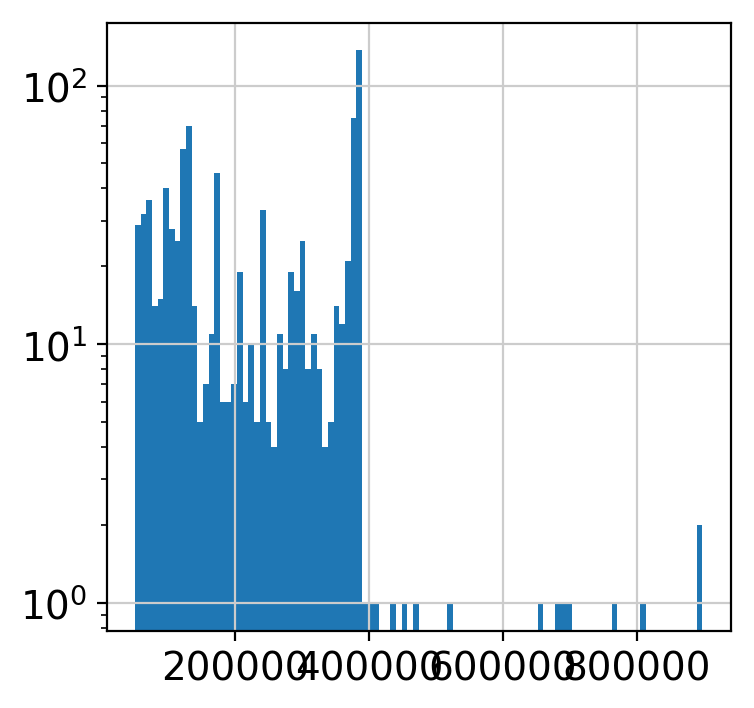

In [21]:
plt.hist(gwas_atlas.obs.N, bins=100);
plt.yscale('log')

In [22]:
gwas_atlas.X[np.isnan(gwas_atlas.X)] = 1.0
gwas_atlas.X[gwas_atlas.X == 0.0] = 1e-40
gwas_atlas.X = -np.log10(gwas_atlas.X)

sc.pp.pca(gwas_atlas, n_comps=200, svd_solver='arpack')
sc.pl.pca(gwas_atlas, color='ChapterLevel', size=35)
sc.pl.pca(gwas_atlas, color='Domain', size=35)
sc.pl.pca_loadings(gwas_atlas)

In [23]:
from scipy.stats import rankdata 
gwas_atlas.obsm['X_rank'] = np.apply_along_axis(rankdata, 0, -gwas_atlas.X) # rank pvals in each study

In [ ]:
sc.pp.neighbors(gwas_atlas, use_rep='X_rank', metric='correlation', n_neighbors=20)

In [25]:
sc.tl.umap(gwas_atlas)

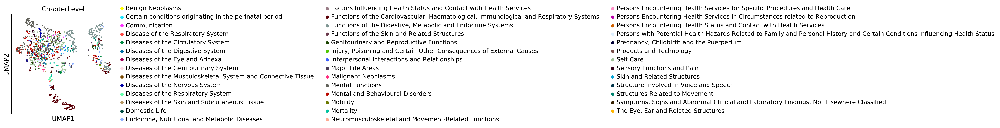

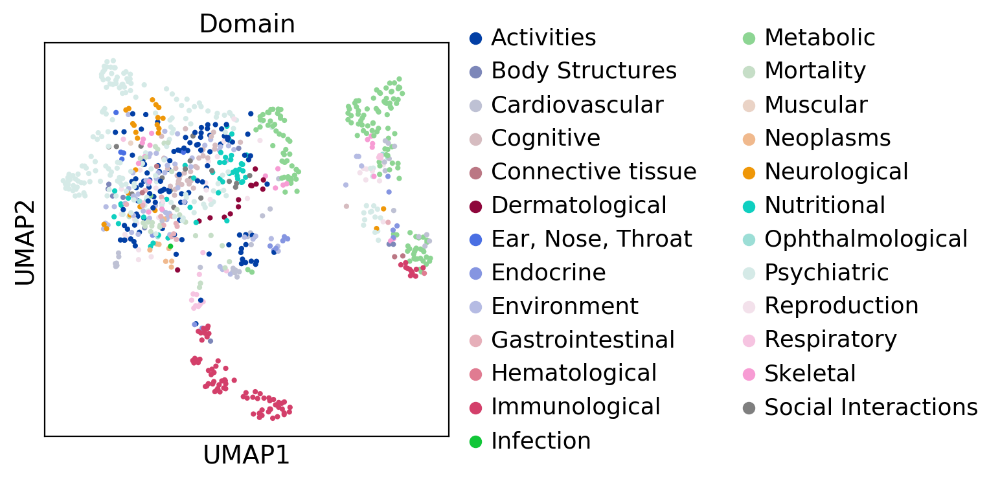

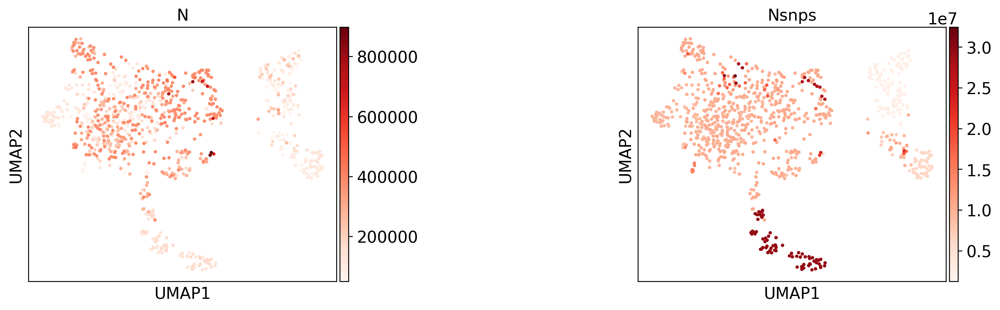

In [26]:
sc.pl.umap(gwas_atlas, color='ChapterLevel', size=35)
sc.pl.umap(gwas_atlas, color='Domain', size=35)
sc.pl.umap(gwas_atlas, color=['N', 'Nsnps'], cmap='Reds', wspace=0.8, size=35)

In [27]:
sc.tl.draw_graph(gwas_atlas, layout='fr')

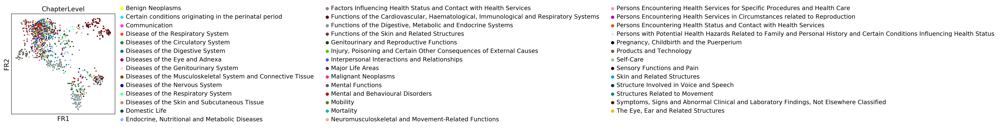

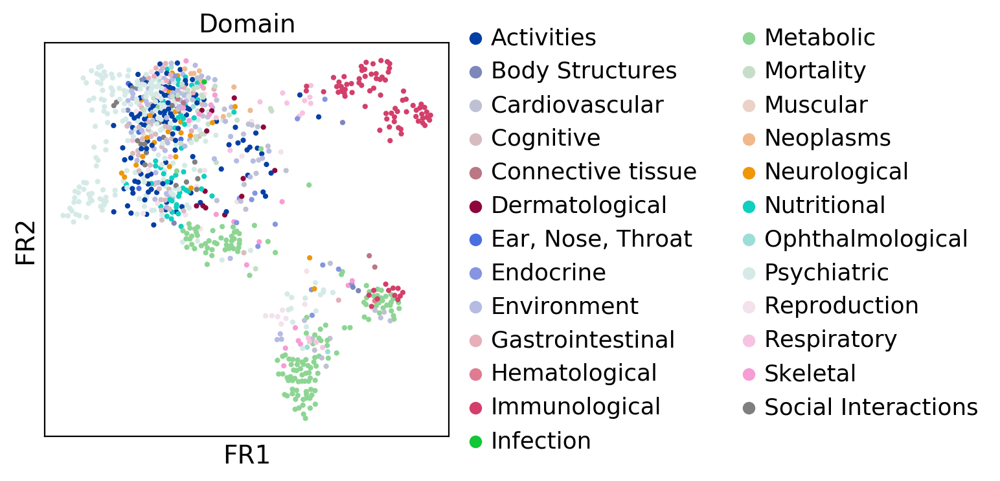

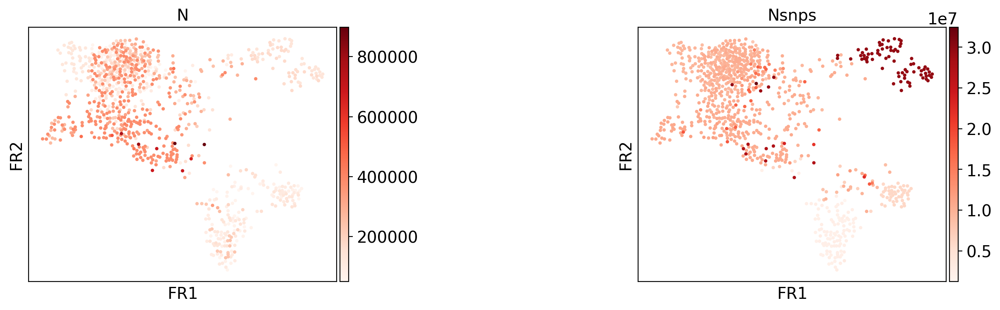

In [28]:
sc.pl.draw_graph(gwas_atlas, color='ChapterLevel', size=35)
sc.pl.draw_graph(gwas_atlas, color='Domain', size=35)
sc.pl.draw_graph(gwas_atlas, color=['N', 'Nsnps'], cmap='Reds', wspace=0.8, size=35)

## Build mutual kNN graph

In [29]:
sc.pp.neighbors(gwas_atlas, use_rep='X_rank', metric='correlation', n_neighbors=40)

In [43]:
def knn2mnn(adata):
    d = adata.uns['neighbors']['distances'] != 0.
    mnn_mask = d.multiply(d.T)
    adata.uns['neighbors']['distances'] = adata.uns['neighbors']['distances'].multiply(mnn_mask)
    adata.uns['neighbors']['connectivities'] = adata.uns['neighbors']['connectivities'].multiply(mnn_mask)

In [36]:
knn2mnn(gwas_atlas)

In [37]:
sc.tl.paga(gwas_atlas, groups='Domain')

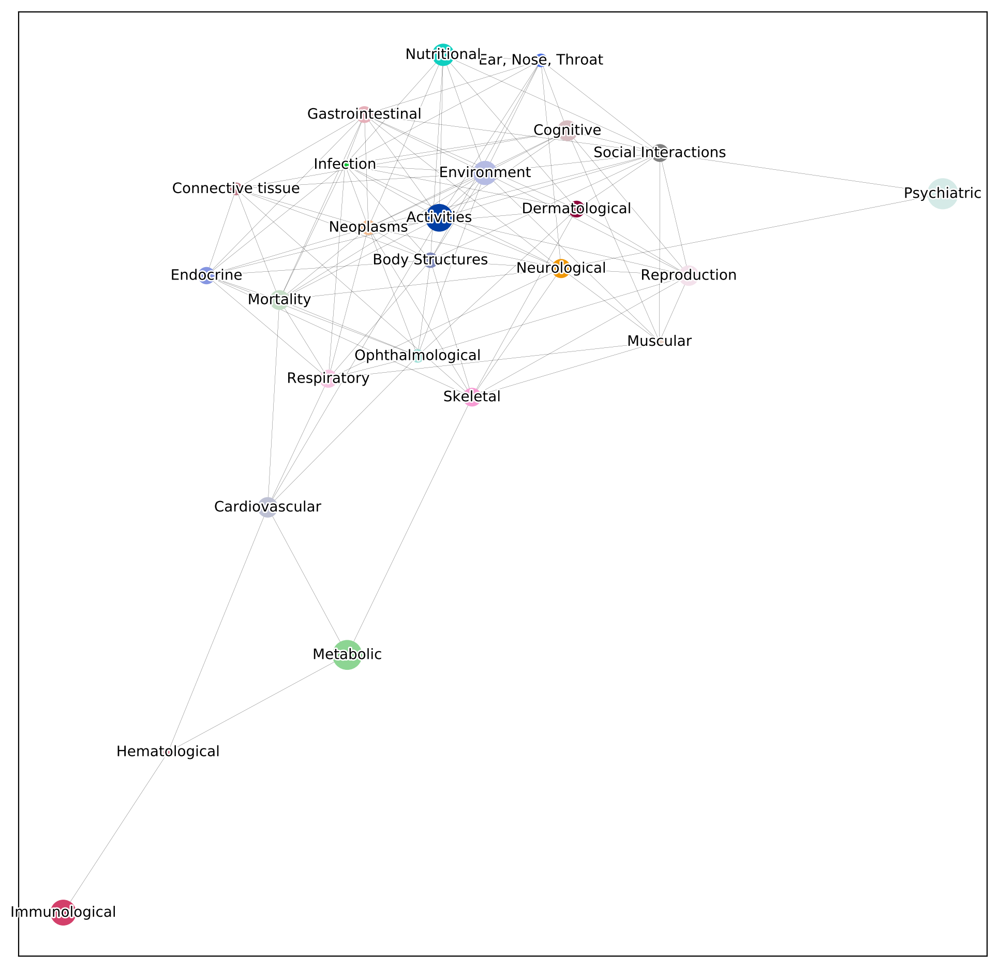

In [38]:
f, ax = plt.subplots(figsize=(12,12))
sc.pl.paga(gwas_atlas, layout='fr', threshold=1., max_edge_width=0.1, fontsize=10., fontoutline=2, fontweight='normal', ax=ax, show=False)

In [45]:
sc.tl.paga(gwas_atlas, groups='ChapterLevel')

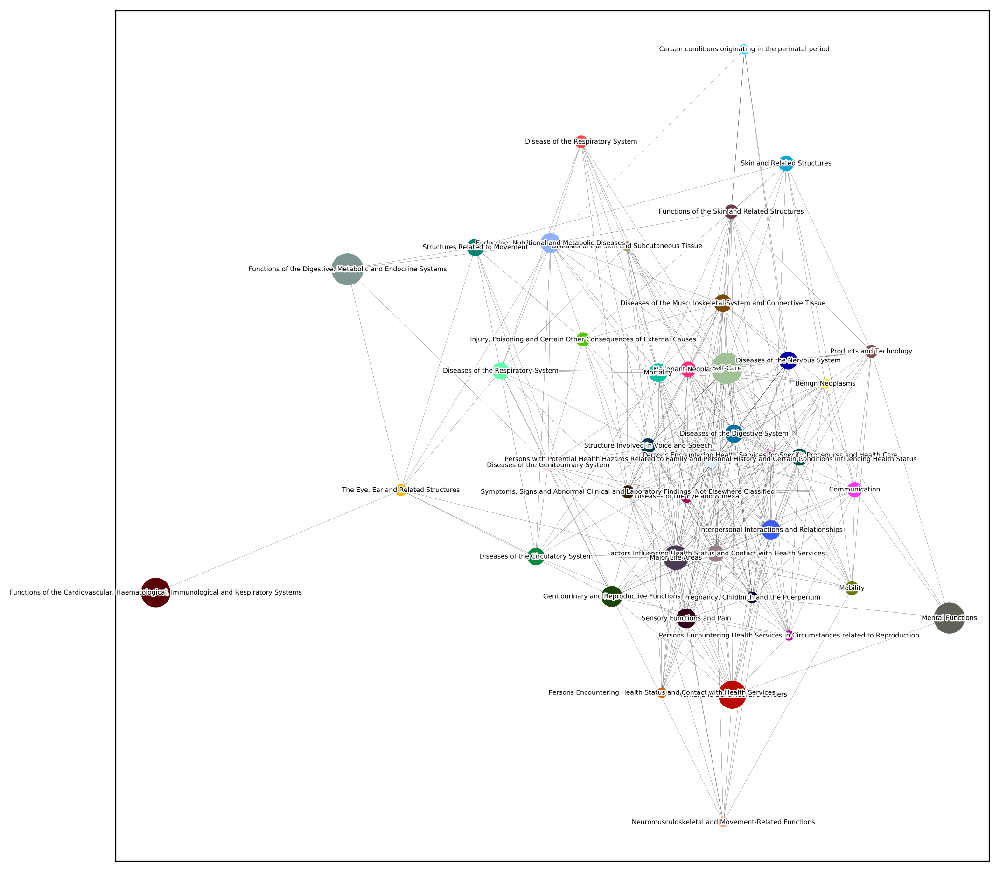

In [46]:
f, ax = plt.subplots(figsize=(12,12))
sc.pl.paga(gwas_atlas, layout='fr', threshold=1., 
           max_edge_width=0.1, fontsize=5., fontoutline=2, fontweight='normal', ax=ax, show=False)

In [41]:
sc.tl.paga(gwas_atlas, groups='uniqTrait')

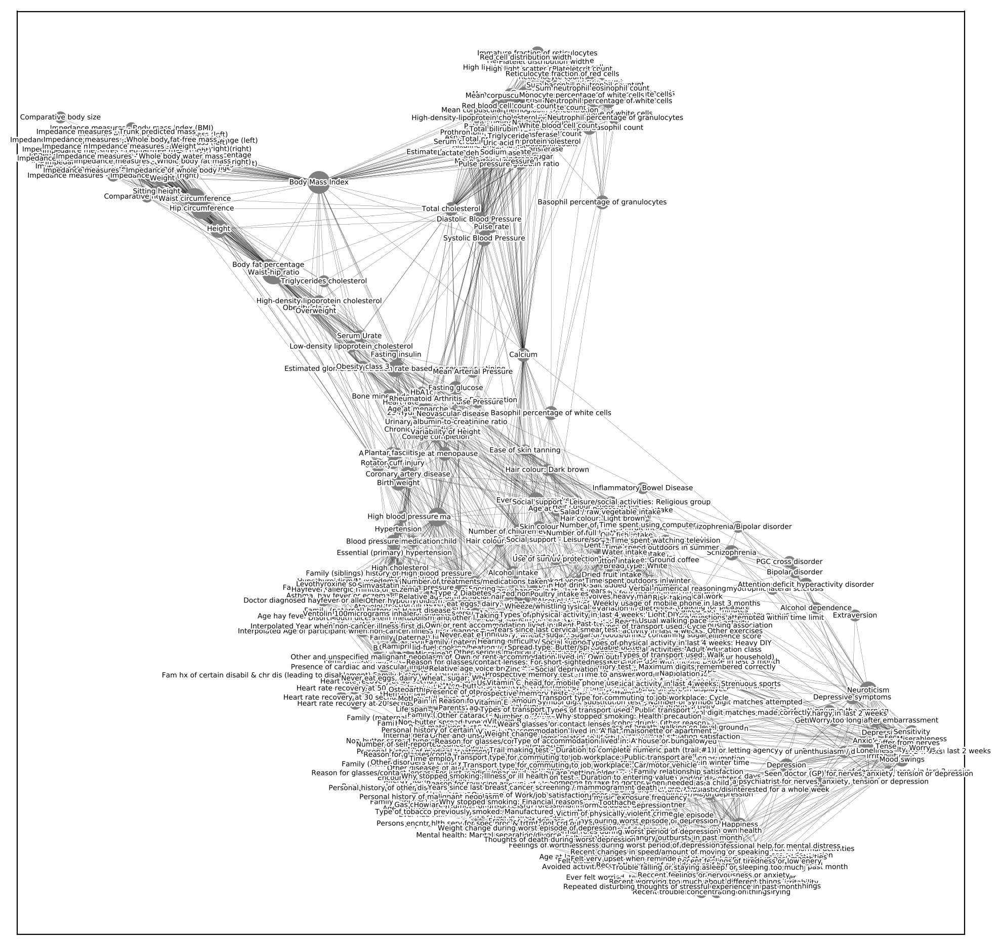

In [42]:
f, ax = plt.subplots(figsize=(12,12))
sc.pl.paga(gwas_atlas, layout='fa', threshold=1.,
           max_edge_width=0.1, fontsize=5., fontoutline=2, fontweight='normal', ax=ax, show=False)

## Cardio & Skeletal

In [47]:
cardio = gwas_atlas[gwas_atlas.obs.Domain.isin(['Cardiovascular', 'Skeletal'])].copy()
cardio.obs.head()

,ChapterLevel,Chi2,Consortium,DateAdded,DateLastModified,Domain,File,Genome,Intercept,LambdaGC,...,PMID,Population,SNPh2,SNPh2_se,SNPh2_z,SubchapterLevel,Trait,Website,Year,uniqTrait
index,,,,,,,,,,,,,,,,,,,,,
108,Diseases of the Circulatory System,1.1214,CARDIoGRAMplusC4D,2016-11-22,2019-01-17,Cardiovascular,http://www.cardiogramplusc4d.org/media/cardiog...,hg19,0.8875,1.0496,...,26343387,EUR+EAS+SAS+AFR,0.0671,0.0042,15.97620,Chronic Ischaemic Heart Disease,Coronary artery disease,http://www.cardiogramplusc4d.org,2015,Coronary artery disease
109,Diseases of the Circulatory System,1.1367,CARDIoGRAMplusC4D,2016-11-26,2019-01-17,Cardiovascular,http://www.cardiogramplusc4d.org/media/cardiog...,hg18,1.0226,1.0988,...,21378990,EUR,0.1152,0.0142,8.11268,Chronic Ischaemic Heart Disease,Coronary artery disease,http://www.cardiogramplusc4d.org,2011,Coronary artery disease
113,Structures Related to Movement,1.3208,GIANT,2017-07-04,2019-01-17,Skeletal,http://portals.broadinstitute.org/collaboratio...,rsID,0.7919,1.0618,...,20881960,EUR,0.1946,0.0104,18.71150,Height,Height,http://www.broadinstitute.org/collaboration/giant,2010,Height
116,Structures Related to Movement,1.0352,GIANT,2017-07-04,2019-01-17,Skeletal,http://portals.broadinstitute.org/collaboratio...,rsID,1.0077,1.0466,...,22982992,EUR,0.0108,0.0040,2.70000,Height,Variability of Height,http://www.broadinstitute.org/collaboration/giant,2012,Variability of Height
126,Structures Related to Movement,1.1464,GIANT,2017-07-04,2019-01-17,Skeletal,http://portals.broadinstitute.org/collaboratio...,rsID,0.8455,1.0466,...,23754948,EUR,0.2469,0.0157,15.72610,Height,Height (male),http://www.broadinstitute.org/collaboration/giant,2013,Height


In [48]:
sc.pp.neighbors(cardio, use_rep='X_rank', metric='correlation', n_neighbors=15)

In [49]:
sc.tl.umap(cardio)

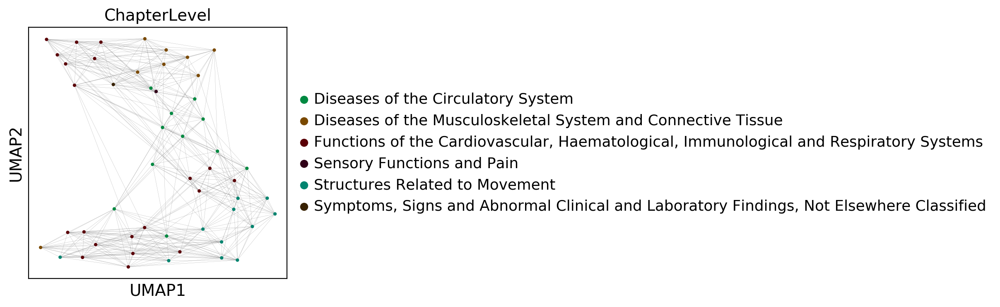

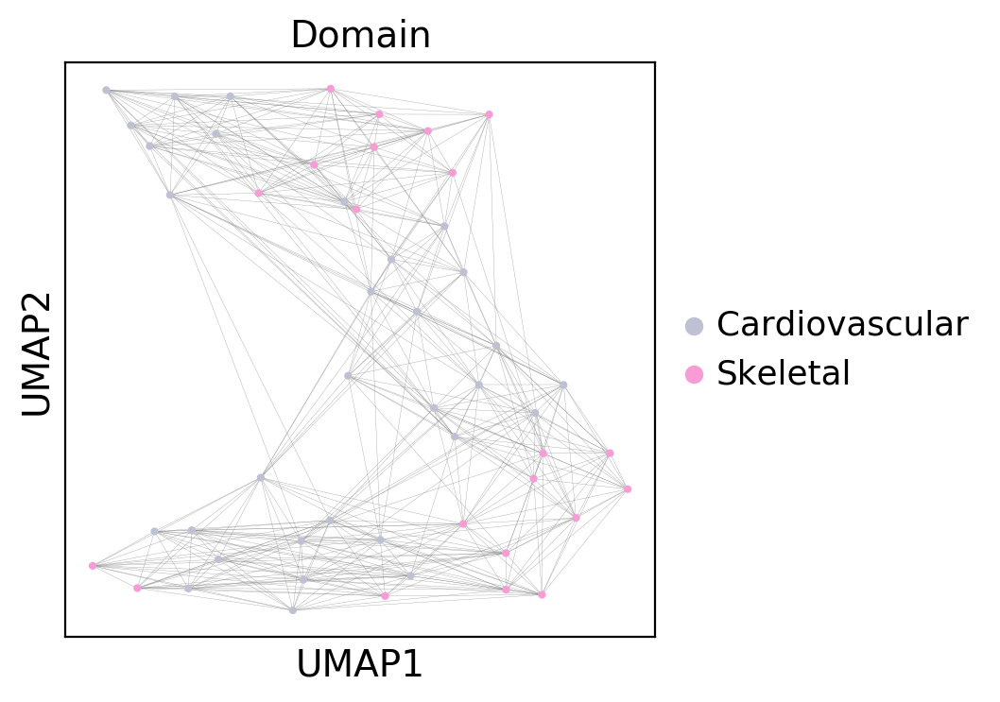

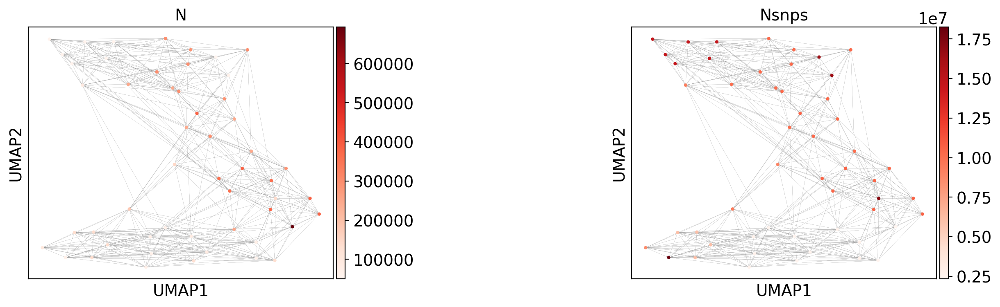

In [51]:
sc.pl.umap(cardio, color='ChapterLevel', size=35, edges=True)
sc.pl.umap(cardio, color='Domain', size=35, edges=True)
sc.pl.umap(cardio, color=['N', 'Nsnps'], cmap='Reds', wspace=0.8, size=35, edges=True)

In [52]:
knn2mnn(cardio)
sc.tl.paga(cardio, groups='uniqTrait')

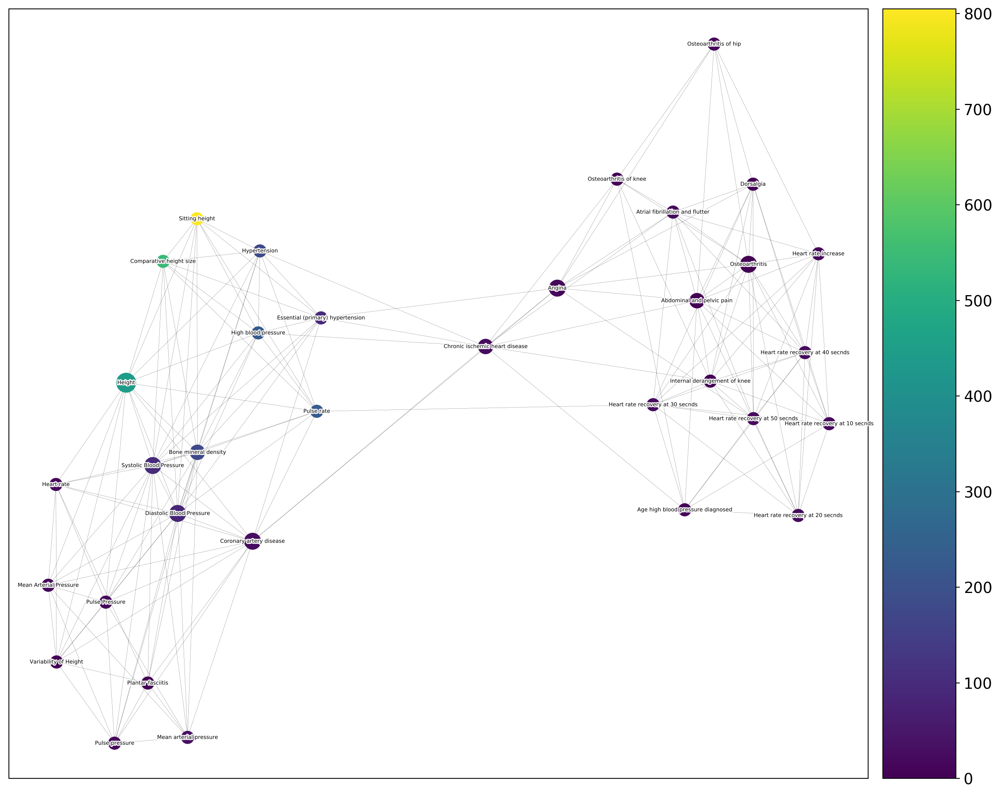

In [53]:
plt.rcParams['figure.figsize'] = (12,12)
sc.pl.paga(cardio, layout='fr', threshold=1., color='Nhits',
           max_edge_width=0.1, fontsize=5., fontoutline=2, fontweight='normal')
plt.rcParams['figure.figsize'] = (4,4)

## Clustering

In [56]:
sc.pp.neighbors(gwas_atlas, use_rep='X_rank', metric='correlation', n_neighbors=20)
sc.tl.leiden(gwas_atlas, resolution=0.2)

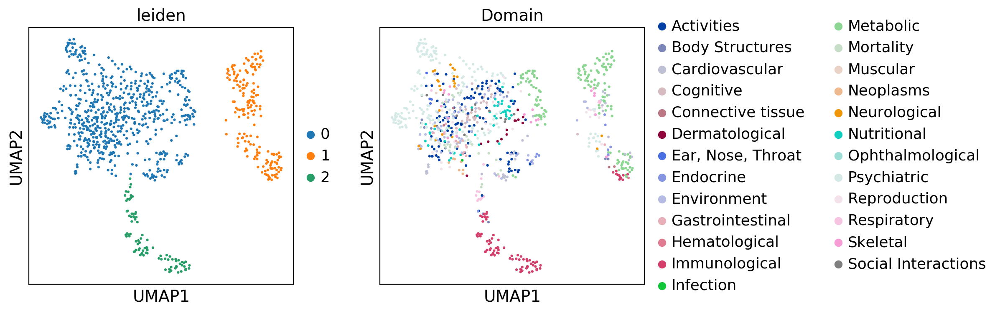

In [57]:
sc.pl.umap(gwas_atlas, color=['leiden', 'Domain'], size=20)

### Psychiatric

In [59]:
gwas_psy = gwas_atlas[gwas_atlas.obs['Domain'] == 'Psychiatric'].copy()
gwas_psy

AnnData object with n_obs × n_vars = 183 × 20061 
    obs: 'ChapterLevel', 'Chi2', 'Consortium', 'DateAdded', 'DateLastModified', 'Domain', 'File', 'Genome', 'Intercept', 'LambdaGC', 'N', 'Ncase', 'Ncontrol', 'Nhits', 'Note', 'Nsnps', 'PMID', 'Population', 'SNPh2', 'SNPh2_se', 'SNPh2_z', 'SubchapterLevel', 'Trait', 'Website', 'Year', 'uniqTrait', 'leiden'
    uns: 'neighbors', 'ChapterLevel_colors', 'Domain_colors', 'draw_graph', 'paga', 'Domain_sizes', 'ChapterLevel_sizes', 'uniqTrait_sizes', 'uniqTrait_colors', 'leiden', 'leiden_colors'
    obsm: 'X_rank', 'X_umap', 'X_draw_graph_fr'

In [68]:
sc.pp.neighbors(gwas_psy, use_rep='X_rank', metric='correlation', n_neighbors=10)

In [69]:
sc.tl.umap(gwas_psy)

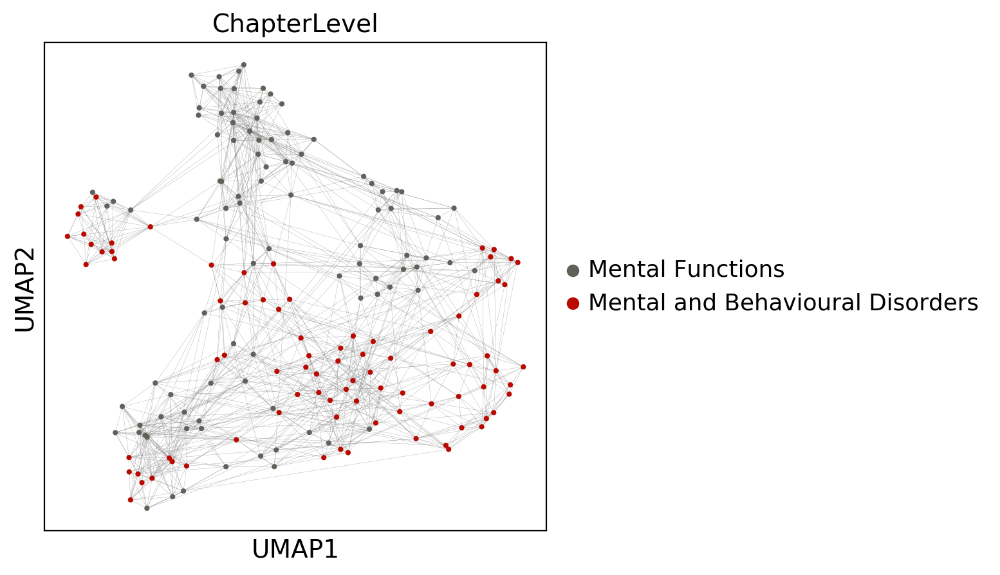

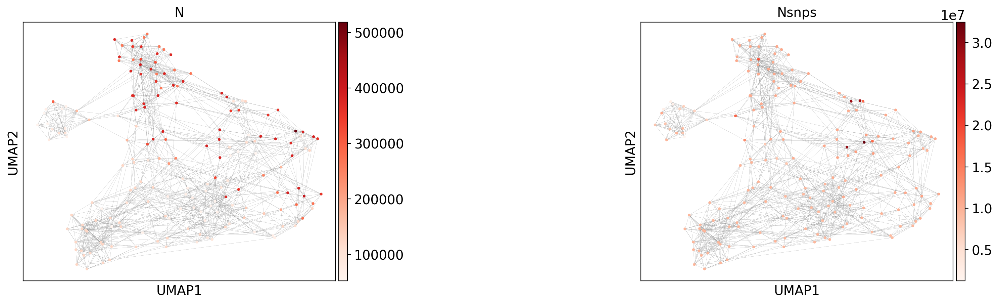

In [70]:
sc.pl.umap(gwas_psy, color='ChapterLevel', size=35, edges=True)
sc.pl.umap(gwas_psy, color=['N', 'Nsnps'], cmap='Reds', wspace=0.8, size=35, edges=True)

In [71]:
knn2mnn(gwas_psy)
sc.tl.paga(gwas_psy, groups='uniqTrait')

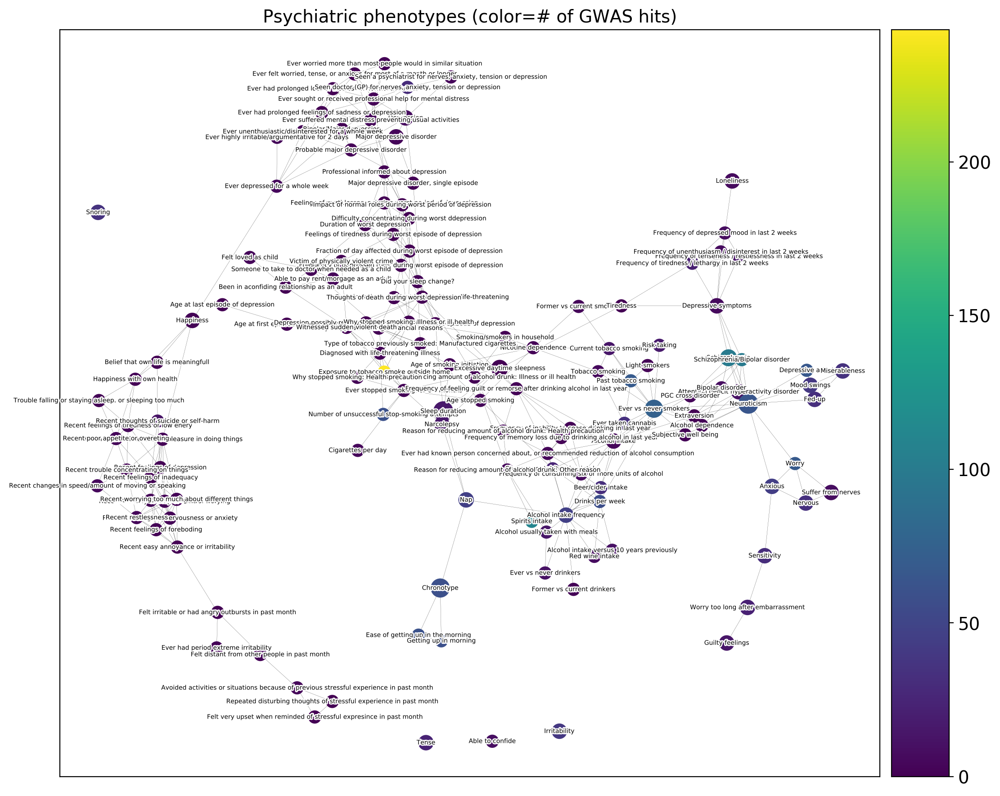

In [72]:
plt.rcParams['figure.figsize'] = (10,10)
sc.pl.paga(gwas_psy, layout='fr', threshold=1., color='Nhits', title='Psychiatric phenotypes (color=# of GWAS hits)',
           max_edge_width=0.1, fontsize=5., fontoutline=2, fontweight='normal')
plt.rcParams['figure.figsize'] = (5,5)

### Metabolic phenotypes

In [73]:
gwas_meta = gwas_atlas[gwas_atlas.obs.Domain == 'Metabolic'].copy()
gwas_meta

AnnData object with n_obs × n_vars = 155 × 20061 
    obs: 'ChapterLevel', 'Chi2', 'Consortium', 'DateAdded', 'DateLastModified', 'Domain', 'File', 'Genome', 'Intercept', 'LambdaGC', 'N', 'Ncase', 'Ncontrol', 'Nhits', 'Note', 'Nsnps', 'PMID', 'Population', 'SNPh2', 'SNPh2_se', 'SNPh2_z', 'SubchapterLevel', 'Trait', 'Website', 'Year', 'uniqTrait', 'leiden'
    uns: 'neighbors', 'ChapterLevel_colors', 'Domain_colors', 'draw_graph', 'paga', 'Domain_sizes', 'ChapterLevel_sizes', 'uniqTrait_sizes', 'uniqTrait_colors', 'leiden', 'leiden_colors'
    obsm: 'X_rank', 'X_umap', 'X_draw_graph_fr'

In [79]:
sc.pp.neighbors(gwas_meta, use_rep='X_rank', metric='correlation', n_neighbors=20)

In [80]:
sc.tl.umap(gwas_meta)

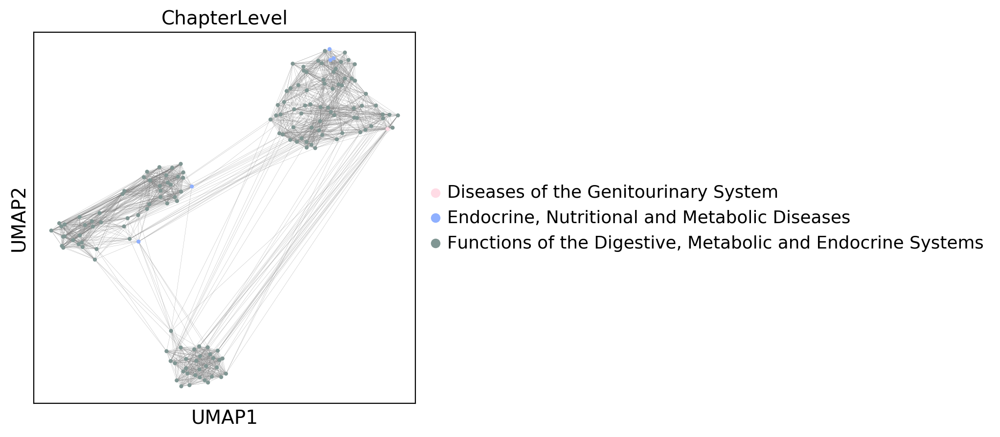

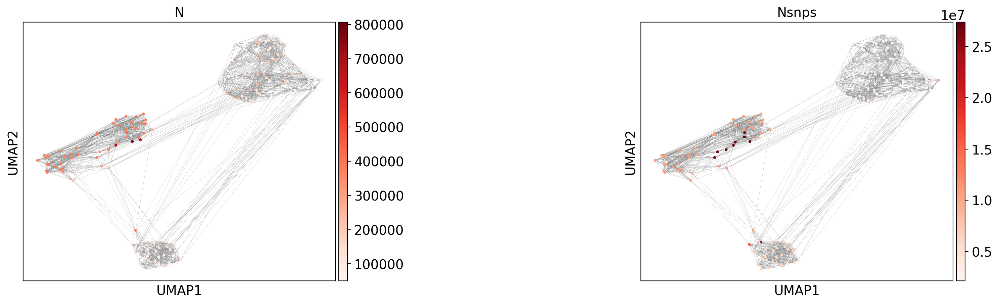

In [81]:
sc.pl.umap(gwas_meta, color='ChapterLevel', size=35, edges=True)
sc.pl.umap(gwas_meta, color=['N', 'Nsnps'], cmap='Reds', wspace=0.8, size=35, edges=True)

In [82]:
knn2mnn(gwas_meta)
sc.tl.paga(gwas_meta, groups='uniqTrait')

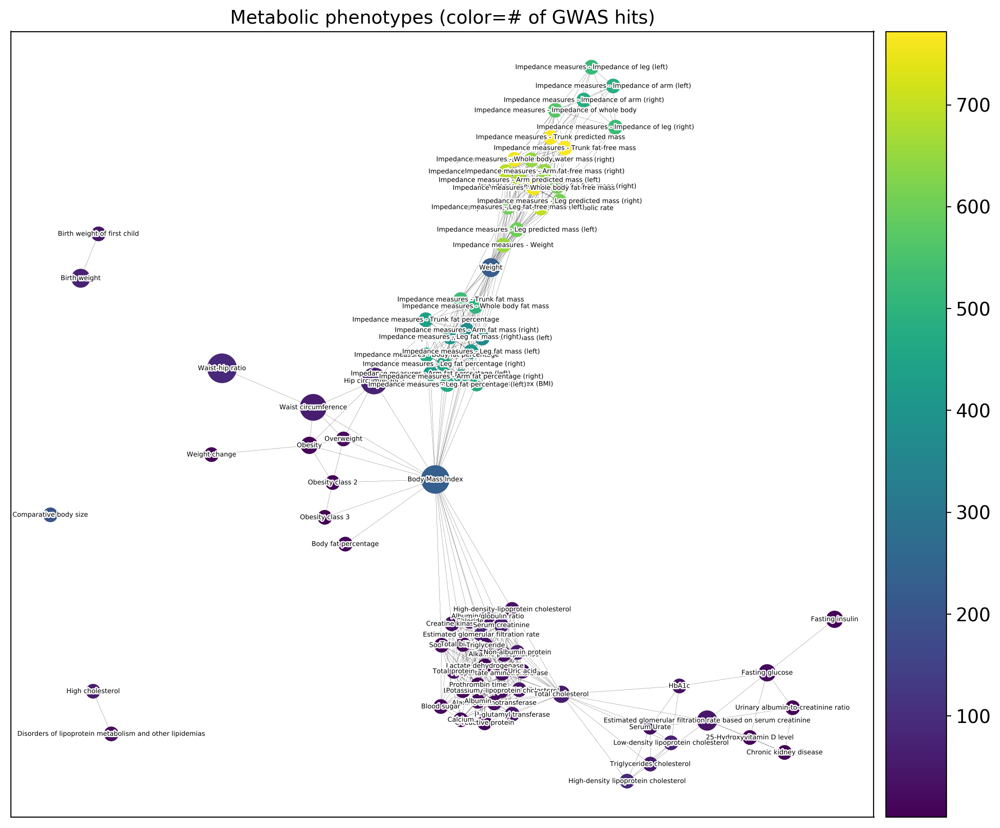

In [83]:
plt.rcParams['figure.figsize'] = (10,10)
sc.pl.paga(gwas_meta, layout='fr', threshold=1., color='Nhits', title='Metabolic phenotypes (color=# of GWAS hits)',
           max_edge_width=0.1, fontsize=5., fontoutline=2, fontweight='normal')
plt.rcParams['figure.figsize'] = (5,5)

### Immune phenotypes

In [84]:
gwas_immune = gwas_atlas[gwas_atlas.obs['Domain'] == 'Immunological'].copy()
gwas_immune

AnnData object with n_obs × n_vars = 84 × 20061 
    obs: 'ChapterLevel', 'Chi2', 'Consortium', 'DateAdded', 'DateLastModified', 'Domain', 'File', 'Genome', 'Intercept', 'LambdaGC', 'N', 'Ncase', 'Ncontrol', 'Nhits', 'Note', 'Nsnps', 'PMID', 'Population', 'SNPh2', 'SNPh2_se', 'SNPh2_z', 'SubchapterLevel', 'Trait', 'Website', 'Year', 'uniqTrait', 'leiden'
    uns: 'neighbors', 'ChapterLevel_colors', 'Domain_colors', 'draw_graph', 'paga', 'Domain_sizes', 'ChapterLevel_sizes', 'uniqTrait_sizes', 'uniqTrait_colors', 'leiden', 'leiden_colors'
    obsm: 'X_rank', 'X_umap', 'X_draw_graph_fr'

In [85]:
sc.pp.neighbors(gwas_immune, use_rep='X_rank', metric='correlation', n_neighbors=10)

In [86]:
sc.tl.umap(gwas_immune)

/home/gokcen/.local/lib/python3.7/site-packages/umap/spectral.py:229: UserWarning: Embedding a total of 2 separate connected components using meta-embedding (experimental)
  n_components


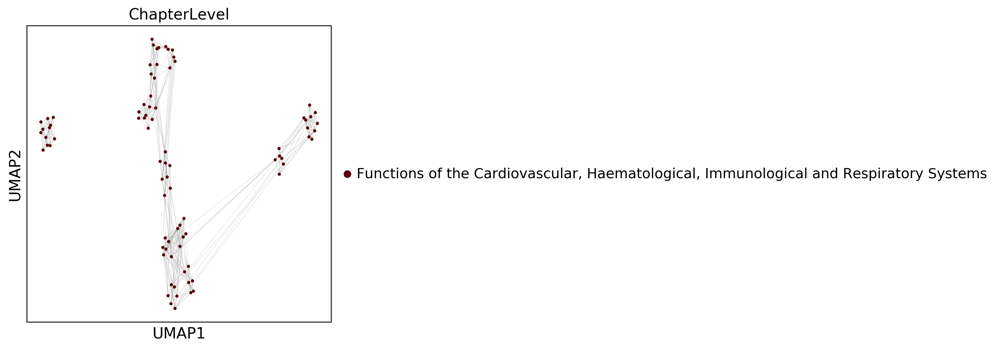

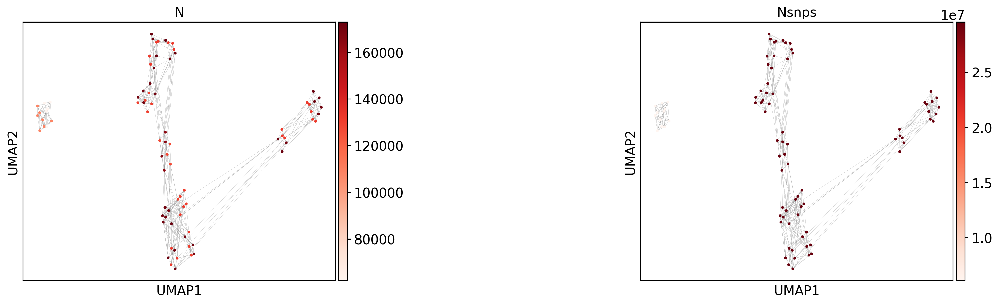

In [87]:
sc.pl.umap(gwas_immune, color='ChapterLevel', size=35, edges=True)
sc.pl.umap(gwas_immune, color=['N', 'Nsnps'], cmap='Reds', wspace=0.8, size=35, edges=True)

In [88]:
knn2mnn(gwas_immune)
sc.tl.paga(gwas_immune, groups='uniqTrait')

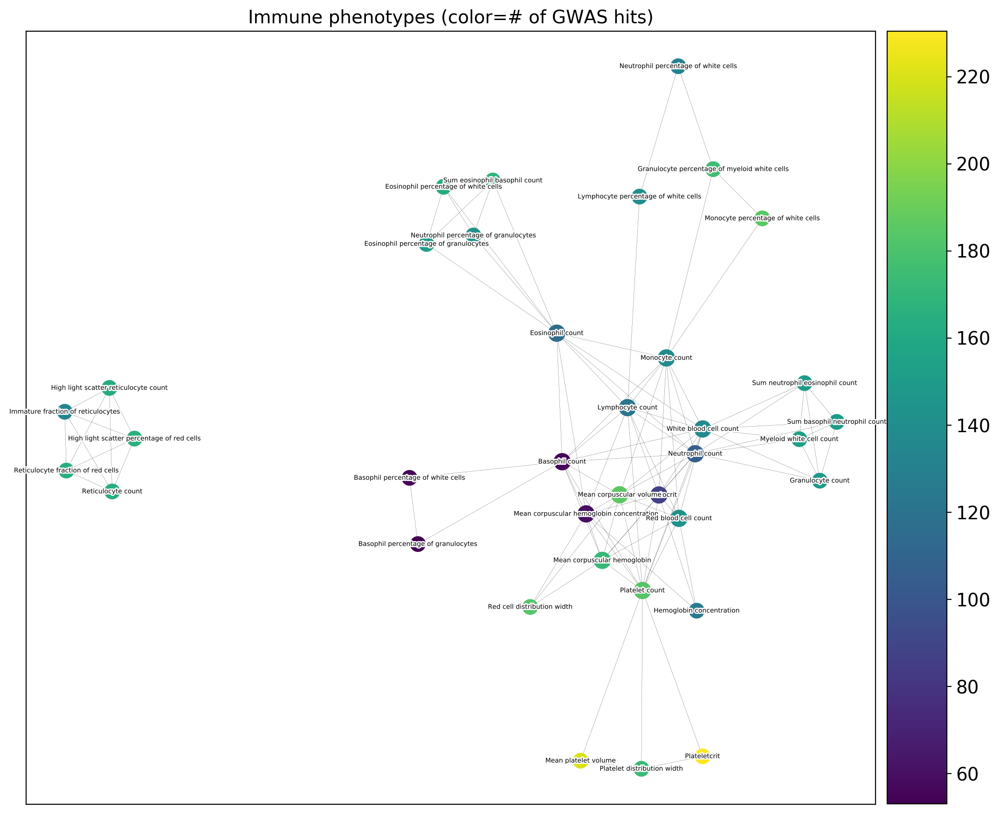

In [89]:
plt.rcParams['figure.figsize'] = (10,10)
sc.pl.paga(gwas_immune, layout='fr', threshold=1., color='Nhits', title='Immune phenotypes (color=# of GWAS hits)',
           max_edge_width=0.1, fontsize=5., fontoutline=2, fontweight='normal')
plt.rcParams['figure.figsize'] = (5,5)

/home/gokcen/.local/lib/python3.7/site-packages/anndata/core/anndata.py:846: FutureWarning: In anndata v0.7+, arrays contained within an AnnData object will maintain their dimensionality. For example, prior to v0.7 `adata[0, 0].X` returned a scalar and `adata[0, :]` returned a 1d array, post v0.7 they will return two dimensional arrays. If you would like to get a one dimensional array from your AnnData object, consider using the `adata.obs_vector`, `adata.var_vector` methods or accessing the array directly.
  warn_flatten()
/home/gokcen/.local/lib/python3.7/site-packages/anndata/core/anndata.py:846: FutureWarning: In anndata v0.7+, arrays contained within an AnnData object will maintain their dimensionality. For example, prior to v0.7 `adata[0, 0].X` returned a scalar and `adata[0, :]` returned a 1d array, post v0.7 they will return two dimensional arrays. If you would like to get a one dimensional array from your AnnData object, consider using the `adata.obs_vector`, `adata.var_vector

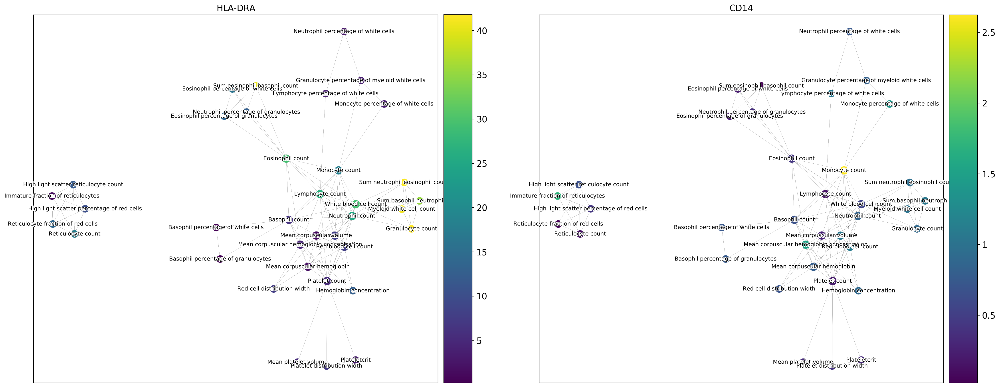

In [90]:
plt.rcParams['figure.figsize'] = (10,10)
sc.pl.paga(gwas_immune, layout='fr', threshold=1., color=['HLA-DRA', 'CD14'],
           max_edge_width=0.1, fontsize=9., fontoutline=2, fontweight='normal')
plt.rcParams['figure.figsize'] = (4,4)

## Activity

In [91]:
act = gwas_atlas[gwas_atlas.obs.Domain == 'Activities'].copy()
act

AnnData object with n_obs × n_vars = 112 × 20061 
    obs: 'ChapterLevel', 'Chi2', 'Consortium', 'DateAdded', 'DateLastModified', 'Domain', 'File', 'Genome', 'Intercept', 'LambdaGC', 'N', 'Ncase', 'Ncontrol', 'Nhits', 'Note', 'Nsnps', 'PMID', 'Population', 'SNPh2', 'SNPh2_se', 'SNPh2_z', 'SubchapterLevel', 'Trait', 'Website', 'Year', 'uniqTrait', 'leiden'
    uns: 'neighbors', 'ChapterLevel_colors', 'Domain_colors', 'draw_graph', 'paga', 'Domain_sizes', 'ChapterLevel_sizes', 'uniqTrait_sizes', 'uniqTrait_colors', 'leiden', 'leiden_colors'
    obsm: 'X_rank', 'X_umap', 'X_draw_graph_fr'

In [99]:
sc.pp.neighbors(act, use_rep='X_rank', metric='correlation', n_neighbors=6)

In [100]:
sc.tl.umap(act)

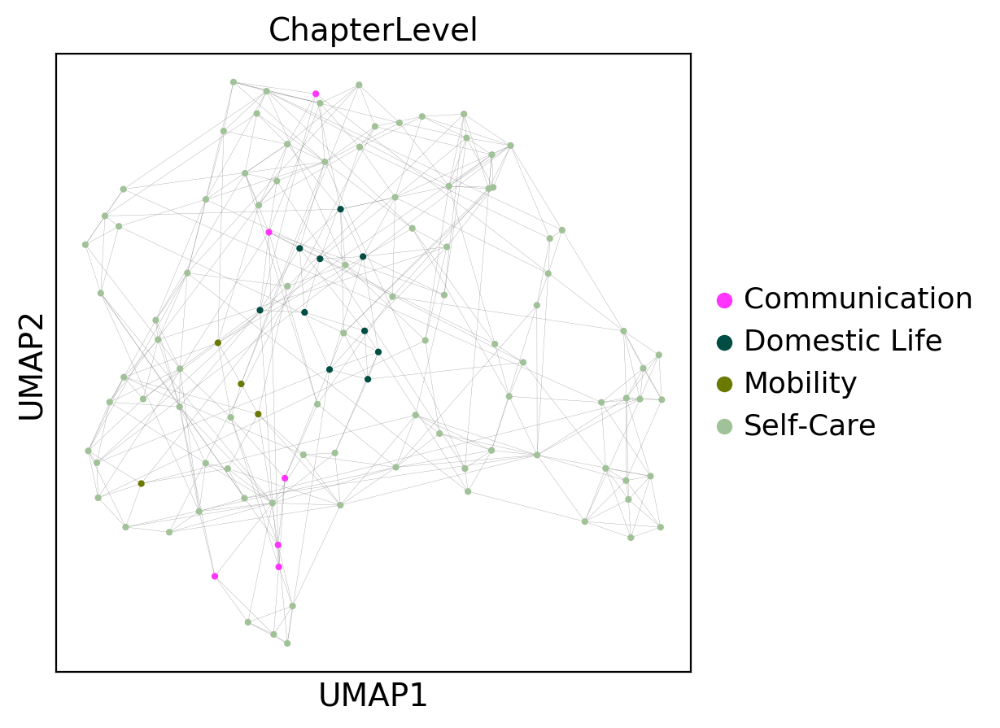

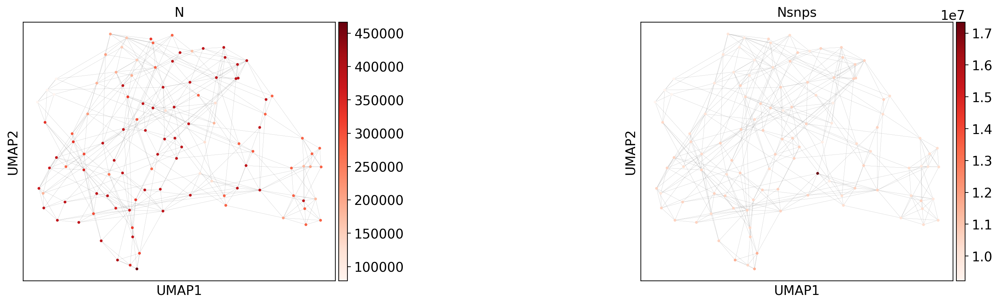

In [101]:
sc.pl.umap(act, color='ChapterLevel', size=35, edges=True)
sc.pl.umap(act, color=['N', 'Nsnps'], cmap='Reds', wspace=0.8, size=35, edges=True)

In [102]:
knn2mnn(act)
sc.tl.paga(act, groups='uniqTrait')

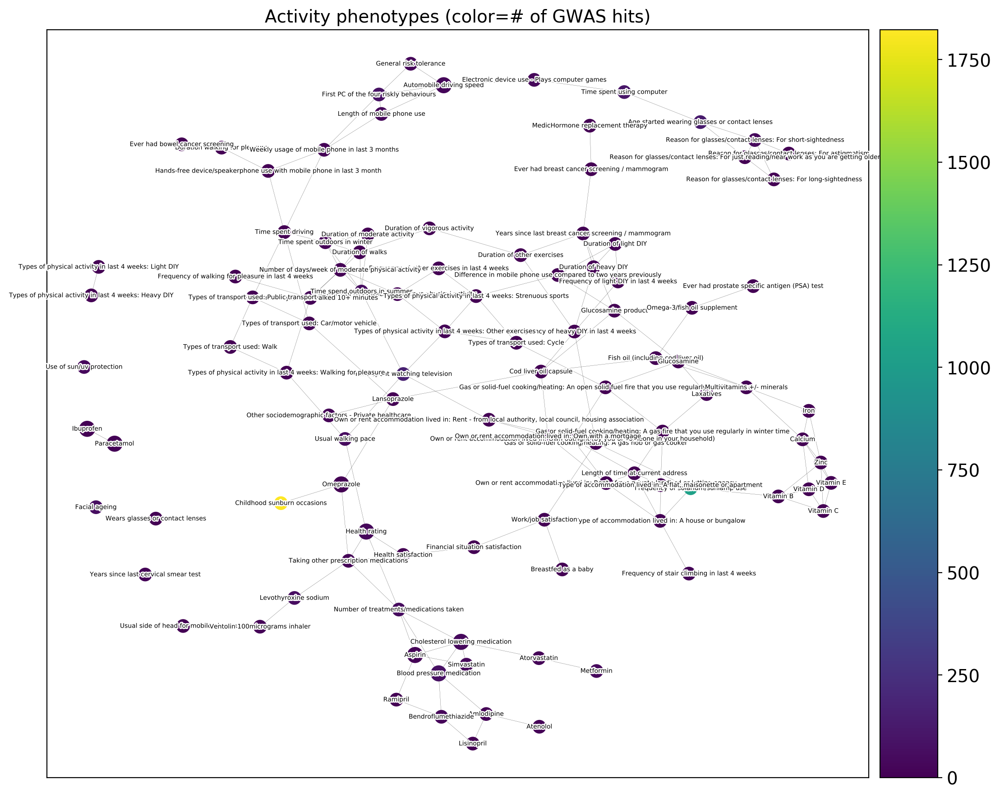

In [103]:
plt.rcParams['figure.figsize'] = (10,10)
sc.pl.paga(act, layout='fr', threshold=1., color='Nhits', title='Activity phenotypes (color=# of GWAS hits)',
           max_edge_width=0.1, fontsize=5., fontoutline=2, fontweight='normal')
plt.rcParams['figure.figsize'] = (5,5)

## Diabetes

In [104]:
dia = gwas_atlas[['DIABETES' in x for x in gwas_atlas.obs.uniqTrait.str.upper().values]].copy()
dia

AnnData object with n_obs × n_vars = 15 × 20061 
    obs: 'ChapterLevel', 'Chi2', 'Consortium', 'DateAdded', 'DateLastModified', 'Domain', 'File', 'Genome', 'Intercept', 'LambdaGC', 'N', 'Ncase', 'Ncontrol', 'Nhits', 'Note', 'Nsnps', 'PMID', 'Population', 'SNPh2', 'SNPh2_se', 'SNPh2_z', 'SubchapterLevel', 'Trait', 'Website', 'Year', 'uniqTrait', 'leiden'
    uns: 'neighbors', 'ChapterLevel_colors', 'Domain_colors', 'draw_graph', 'paga', 'Domain_sizes', 'ChapterLevel_sizes', 'uniqTrait_sizes', 'uniqTrait_colors', 'leiden', 'leiden_colors'
    obsm: 'X_rank', 'X_umap', 'X_draw_graph_fr'

In [105]:
sc.pp.neighbors(dia, use_rep='X_rank', metric='correlation', n_neighbors=4)

In [106]:
if 'uniqTrait_colors' in dia.uns_keys():
    del dia.uns['uniqTrait_colors']

if 'Domain_colors' in dia.uns_keys():
    del dia.uns['Domain_colors']

if 'ChapterLevel_colors' in dia.uns_keys():
    del dia.uns['ChapterLevel_colors']

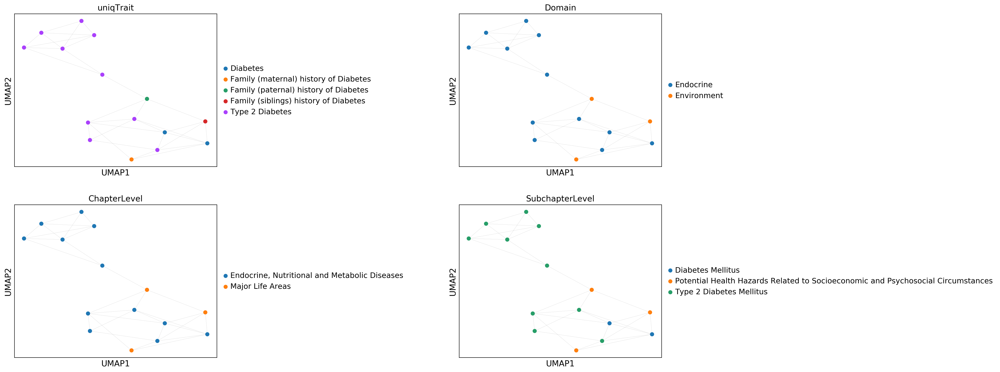

In [107]:
sc.tl.umap(dia)
sc.pl.umap(dia, edges=True, size=200, color=['uniqTrait', 'Domain', 'ChapterLevel', 'SubchapterLevel'], wspace=1., ncols=2)

In [108]:
dia.obs.head()

,ChapterLevel,Chi2,Consortium,DateAdded,DateLastModified,Domain,File,Genome,Intercept,LambdaGC,...,Population,SNPh2,SNPh2_se,SNPh2_z,SubchapterLevel,Trait,Website,Year,uniqTrait,leiden
index,,,,,,,,,,,,,,,,,,,,,
88,"Endocrine, Nutritional and Metabolic Diseases",1.1275,DIAGRAM,2016-11-22,2019-01-17,Endocrine,http://diagram-consortium.org/downloads.html,hg18,1.0091,1.0957,...,EUR,0.1482,0.0151,9.81457,Type 2 Diabetes Mellitus,Type 2 Diabetes,http://diagram-consortium.org,2012,Type 2 Diabetes,1
1140,"Endocrine, Nutritional and Metabolic Diseases",0.9969,T2D-GENES,2017-07-10,2019-01-17,Endocrine,http://www.t2diabetesgenes.org/datasets/t2d_do...,hg19,0.9706,0.9986,...,UKB1 (EUR),0.0819,0.0211,3.88152,Type 2 Diabetes Mellitus,Type 2 Diabetes (Dominance deviation model),http://www.t2diabetesgenes.org/data/,2016,Type 2 Diabetes,0
1211,"Endocrine, Nutritional and Metabolic Diseases",1.1014,DIAGRAM,2017-07-10,2019-01-17,Endocrine,http://diagram-consortium.org/downloads.html,hg18,0.9668,1.0466,...,EUR+EAS+SAS+AMR,0.0865,0.0070,12.35710,Type 2 Diabetes Mellitus,Type 2 Diabetes,http://diagram-consortium.org,2014,Type 2 Diabetes,1
3328,"Endocrine, Nutritional and Metabolic Diseases",1.3606,,2017-09-26,2019-06-12,Endocrine,https://atlas.ctglab.nl/ukb2_sumstats/f.2443.0...,hg19,1.0537,1.2697,...,UKB2 (EUR),0.2113,0.0118,17.90680,Diabetes Mellitus,Diabetes (diagnosed by doctor),https://atlas.ctglab.nl,2017,Diabetes,0
3601,"Endocrine, Nutritional and Metabolic Diseases",1.2803,,2017-09-26,2019-06-12,Endocrine,https://atlas.ctglab.nl/ukb2_sumstats/20002_12...,hg19,1.0491,1.2136,...,UKB2 (EUR),0.1954,0.0130,15.03080,Diabetes Mellitus,"Non-cancer illness code, self-reported: diabetes",https://atlas.ctglab.nl,2017,Diabetes,0


In [109]:
dia_genes = list(set(np.concatenate([dia.var_names[dia.X[x] > (-np.log10(0.01/20000))].values for x in range(dia.shape[0])]).flatten().tolist()))

In [110]:
len(dia_genes)

609

In [111]:
dia_genes = np.array(dia_genes)[dia[:, dia_genes].X.sum(0).argsort()[::-1][:200]]
dia_genes

array(['TCF7L2', 'IGF2BP2', 'CDKAL1', 'FTO', 'THADA', 'KCNQ1', 'WFS1',
       'ZMIZ1', 'HLA-DQB1', 'HNF1B', 'JAZF1', 'HMGA2', 'IDE', 'ZFP36L2',
       'BAG6', 'ADCY5', 'HLA-DRB1', 'PPARG', 'NKX6-3', 'DDX39B', 'KIF11',
       'ATP6V1G2-DDX39B', 'KCNJ11', 'MACF1', 'RP11-366L20.2', 'HLA-DQA1',
       'PSORS1C2', 'HLA-DRA', 'ARAP1', 'MARCH5', 'PRC1', 'UBE2E2',
       'ARL15', 'PABPC4', 'AC022431.2', 'POU5F1', 'TIMP4', 'PROX1',
       'CCND2', 'NCR3LG1', 'UBE3C', 'MCCD1', 'PRRC2A', 'CDC123', 'ATF6B',
       'KLHL42', 'PPT2-EGFL8', 'CCHCR1', 'CENPW', 'MICB', 'PPT2',
       'CDKN2B', 'APOC1', 'ANK1', 'MANSC4', 'CLIC1', 'C6orf10', 'TNXB',
       'C15orf38', 'PRRT1', 'SLC44A4', 'LTBP3', 'TCF19', 'GIPR', 'ACSL1',
       'C15orf38-AP3S2', 'GCKR', 'AP3S2', 'DDAH2', 'NOTCH2', 'ADAM30',
       'MTNR1B', 'PLEKHA1', 'NOTCH4', 'COBLL1', 'FAF1', 'ANKH', 'SSR1',
       'CTRB1', 'TSPAN8', 'NDUFAF6', 'GPSM1', 'EHMT2', 'TLE1', 'SNF8',
       'UBE2Z', 'AGER', 'ST6GAL1', 'NFKBIL1', 'TP53INP1', 'HNF1A',
      

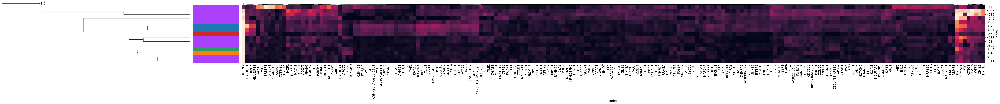

In [113]:
sc.pl.clustermap(dia[:, dia_genes], 'uniqTrait', figsize=(80,5), standard_scale='var')

In [114]:
gwas_atlas.obs['diabetes_score'] = gwas_atlas[:, dia_genes].X.mean(1)

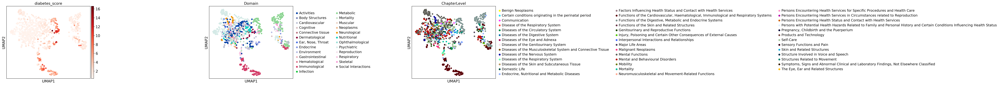

In [115]:
sc.pl.umap(gwas_atlas, color=['diabetes_score', 'Domain', 'ChapterLevel'], cmap='Reds', wspace=1.2)

In [116]:
gwas_atlas.obs.sort_values('diabetes_score', ascending=False).head()

,ChapterLevel,Chi2,Consortium,DateAdded,DateLastModified,Domain,File,Genome,Intercept,LambdaGC,...,SNPh2,SNPh2_se,SNPh2_z,SubchapterLevel,Trait,Website,Year,uniqTrait,leiden,diabetes_score
index,,,,,,,,,,,,,,,,,,,,,
3187,Structures Related to Movement,4.3406,,2017-09-26,2019-06-12,Skeletal,https://atlas.ctglab.nl/ukb2_sumstats/f.50.0.0...,hg19,1.9837,3.1550,...,0.3097,0.0112,27.6518,Height,Standing height,https://atlas.ctglab.nl,2017,Height,0,16.614220
4085,"Endocrine, Nutritional and Metabolic Diseases",1.8816,DIAGRAM,2018-10-19,2019-01-17,Endocrine,http://diagram-consortium.org/downloads.html,hg19,1.0830,1.5585,...,0.1433,0.0049,29.2449,Type 2 Diabetes Mellitus,Type 2 Diabetes,http://diagram-consortium.org/index.html,2018,Type 2 Diabetes,0,13.420625
3412,Structures Related to Movement,3.3508,,2017-09-26,2019-06-12,Skeletal,https://atlas.ctglab.nl/ukb2_sumstats/f.20015....,hg19,1.5619,2.4190,...,0.2353,0.0090,26.1444,Height,Sitting height,https://atlas.ctglab.nl,2017,Sitting height,0,13.309848
3470,"Functions of the Digestive, Metabolic and Endo...",3.2413,,2017-09-26,2019-06-12,Metabolic,https://atlas.ctglab.nl/ukb2_sumstats/f.23129....,hg19,1.4524,2.4840,...,0.2377,0.0079,30.0886,Weight Maintenance Functions,Impedance measures - Trunk fat-free mass,https://atlas.ctglab.nl,2017,Impedance measures - Trunk fat-free mass,0,11.859308
3471,"Functions of the Digestive, Metabolic and Endo...",3.2314,,2017-09-26,2019-06-12,Metabolic,https://atlas.ctglab.nl/ukb2_sumstats/f.23130....,hg19,1.4487,2.4747,...,0.2369,0.0079,29.9873,Weight Maintenance Functions,Impedance measures - Trunk predicted mass,https://atlas.ctglab.nl,2017,Impedance measures - Trunk predicted mass,0,11.808638


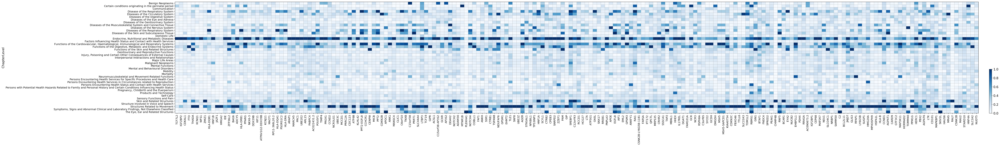

GridSpec(2, 3, height_ratios=[0, 10.5], width_ratios=[64.0, 0, 0.2])

In [117]:
sc.pl.matrixplot(gwas_atlas, dia_genes, groupby='ChapterLevel', standard_scale='var', cmap='Blues')

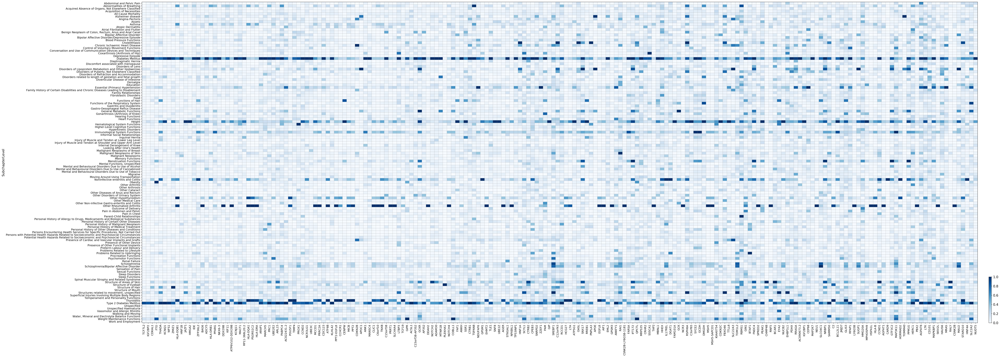

GridSpec(2, 3, height_ratios=[0, 10.5], width_ratios=[64.0, 0, 0.2])

In [118]:
sc.pl.matrixplot(gwas_atlas, dia_genes, groupby='SubchapterLevel', standard_scale='var', cmap='Blues')